In [1]:
%load_ext autoreload
%autoreload 2

import sys
import os
import time

import matplotlib.pyplot as plt
%matplotlib inline
from multiprocess import Pool
import numpy as np

sys.path.append(os.environ['REPO_DIR'] + '/utilities')
from utilities2015 import *
from metadata import *
from data_manager import *

Setting environment for Precision WorkStation


No vtk


In [2]:
# detector_id = 998
detector_id = 799

In [3]:
output_resolution = '10.0um'

# Regular

In [6]:
for stack in ['CHATM3']:
    
    # Specify isotropic resolution of the output volume.
    out_resolution_um = convert_resolution_string_to_um(resolution=output_resolution, stack=stack)

    for structure in ['7N']:
        
        scoremaps = {}

        for sec in metadata_cache['valid_sections'][stack]:

            scoremap = DataManager.load_downscaled_scoremap(stack=stack, section=sec, structure=structure, 
                                                            prep_id='alignedBrainstemCrop',
                                                          out_resolution_um=out_resolution_um, 
                                                            detector_id=detector_id).astype(np.float32)

            mask = DataManager.load_image_v2(stack=stack, section=sec, 
                                 prep_id='alignedBrainstemCrop', 
                                 resol='thumbnail', version='mask')
            
            mask_outResol = rescale_by_resampling(mask, new_shape=(scoremap.shape[1], scoremap.shape[0]))
            
            scoremap[~mask_outResol] = 0
            scoremaps[sec] = scoremap

        volume_outVolResol, volume_origin_wrt_wholebrainXYcropped_outVolResol = \
        images_to_volume_v2(images=scoremaps, spacing_um=20.,
                                in_resol_um=out_resolution_um,
                                out_resol_um=out_resolution_um)
        print volume_outVolResol.shape
        
        
        brain_spec = dict(name=stack,
                       vol_type='score',
                        detector_id=detector_id,
                       resolution=output_resolution)
        
        # Save volume and origin.
        
        save_data(volume_outVolResol.astype(np.float16), DataManager.get_original_volume_filepath_v2(stack_spec=brain_spec, structure=structure))
        
        
        wholebrainXYcropped_origin_wrt_wholebrain_outVolResol = \
        DataManager.get_domain_origin(stack=stack, domain='wholebrainXYcropped', 
                                      resolution=output_resolution)
        volume_origin_wrt_wholebrain_outVolResol =\
        volume_origin_wrt_wholebrainXYcropped_outVolResol + wholebrainXYcropped_origin_wrt_wholebrain_outVolResol

        save_data(volume_origin_wrt_wholebrain_outVolResol,
                  DataManager.get_original_volume_origin_filepath_v3(stack_spec=brain_spec, structure=structure, wrt='wholebrain'))
        
        # Compute gradients.
        
        gradients = compute_gradient_v2((volume_outVolResol, volume_origin_wrt_wholebrain_outVolResol), 
                                        smooth_first=True)
        
        DataManager.save_volume_gradients(gradients, stack_spec=brain_spec, structure=structure)

Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide27_2018_02_17-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide28_2018_02_17-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide27_2018_02_17-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide28_2018_02_17-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide29_2018_02_17-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide30_2018_02_17-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide29_2018_02_17-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide30_2018_02_17-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide29_2018_02_17-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide30_2018_02_17-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide32_2018_02_17-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide31_2018_02_17-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide32_2018_02_17-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide31_2018_02_17-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide33_2018_02_17-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide34_2018_02_17-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide33_2018_02_17-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide34_2018_02_17-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide33_2018_02_17-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide34_2018_02_17-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide35_2018_02_17-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide36_2018_02_17-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide35_2018_02_17-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide36_2018_02_17-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide35_2018_02_17-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide37_2018_02_18-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide38_2018_02_19-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide37_2018_02_18-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide38_2018_02_19-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide37_2018_02_18-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide38_2018_02_19-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide39_2018_02_19-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide40_2018_02_18-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide39_2018_02_19-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide40_2018_02_18-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide39_2018_02_19-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide40_2018_02_18-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide41_2018_02_18-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide42_2018_02_19-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide41_2018_02_18-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide42_2018_02_19-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide41_2018_02_18-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide42_2018_02_19-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide44_2018_02_19-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide43_2018_02_19-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide44_2018_02_19-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide44_2018_02_19-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide45_2018_02_18-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide45_2018_02_18-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide46_2018_02_19-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide45_2018_02_18-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide46_2018_02_19-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide47_2018_02_18-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide48_2018_02_18-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide47_2018_02_18-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide48_2018_02_18-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide47_2018_02_18-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide48_2018_02_18-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide49_2018_02_18-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide50_2018_02_18-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide49_2018_02_18-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide50_2018_02_18-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide49_2018_02_18-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide50_2018_02_18-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide51_2018_02_18-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide52_2018_02_19-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide51_2018_02_18-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide51_2018_02_18-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide52_2018_02_19-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide53_2018_02_18-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide54_2018_02_18-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide53_2018_02_18-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide54_2018_02_18-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide53_2018_02_18-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide54_2018_02_18-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide56_2018_02_18-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide55_2018_02_18-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide56_2018_02_18-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide55_2018_02_18-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide56_2018_02_18-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide55_2018_02_18-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide57_2018_02_18-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide58_2018_02_19-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide57_2018_02_18-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide58_2018_02_19-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide57_2018_02_18-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide58_2018_02_19-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide59_2018_02_19-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide60_2018_02_19-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide59_2018_02_19-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide60_2018_02_19-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide59_2018_02_19-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide60_2018_02_19-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide61_2018_02_19-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide62_2018_02_19-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide62_2018_02_19-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide62_2018_02_19-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide63_2018_02_19-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide64_2018_02_19-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide63_2018_02_19-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide64_2018_02_19-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide63_2018_02_19-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide64_2018_02_19-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide65_2018_02_19-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide66_2018_02_19-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide66_2018_02_19-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide65_2018_02_19-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide66_2018_02_19-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide67_2018_02_19-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide68_2018_02_19-S1_prep2_thumbnail_mask.png


Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide67_2018_02_19-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide68_2018_02_19-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide67_2018_02_19-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide68_2018_02_19-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide69_2018_02_19-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide70_2018_02_19-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide69_2018_02_19-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide70_2018_02_19-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide69_2018_02_19-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide70_2018_02_19-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide71_2018_02_19-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide72_2018_02_19-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide71_2018_02_19-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide72_2018_02_19-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide71_2018_02_19-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide72_2018_02_19-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide73_2018_01_26-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide73_2018_01_26-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide73_2018_01_26-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide75_2018_01_26-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide75_2018_01_26-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide75_2018_01_26-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide77_2018_01_26-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide77_2018_01_26-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide77_2018_01_26-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide79_2018_01_26-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide79_2018_01_26-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide79_2018_01_26-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide83_2018_01_26-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide83_2018_01_26-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide85_2018_01_26-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide85_2018_01_26-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide85_2018_01_26-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide87_2018_01_26-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide87_2018_01_26-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide87_2018_01_26-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide89_2018_01_26-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide89_2018_01_26-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide91_2018_01_26-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide91_2018_01_26-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide93_2018_01_26-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide93_2018_01_26-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide93_2018_01_26-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide95_2018_01_26-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide95_2018_01_26-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide95_2018_01_26-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide97_2018_01_26-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide97_2018_01_26-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide97_2018_01_26-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide99_2018_01_26-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide99_2018_01_26-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide99_2018_01_26-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide101_2018_01_26-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide101_2018_01_26-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide101_2018_01_26-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide103_2018_01_26-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide103_2018_01_26-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide103_2018_01_26-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide105_2018_01_26-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide105_2018_01_26-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide105_2018_01_26-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide107_2018_01_26-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide107_2018_01_26-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide107_2018_01_26-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide109_2018_01_26-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide109_2018_01_26-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide111_2018_01_26-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide111_2018_01_26-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide111_2018_01_26-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide113_2018_01_26-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide113_2018_01_26-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide113_2018_01_26-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide115_2018_01_26-S1_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.
Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide115_2018_01_26-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide115_2018_01_26-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide117_2018_01_26-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide117_2018_01_26-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide117_2018_01_26-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide119_2018_01_26-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide119_2018_01_26-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide119_2018_01_26-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide121_2018_01_26-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide121_2018_01_26-S2_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide121_2018_01_26-S3_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide123_2018_01_26-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide123_2018_01_26-S2_prep2_thumbnail_mask.png


Not using image_cache.
Not using image_cache.
Not using image_cache.


/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide123_2018_01_26-S3_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide125_2018_01_26-S1_prep2_thumbnail_mask.png
/data/CSHL_data_processed/CHATM3/CHATM3_prep2_thumbnail_mask/CHATM3_slide125_2018_01_26-S2_prep2_thumbnail_mask.png


/usr/local/lib/python2.7/dist-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


(604, 872, 591)


Setting environment for Precision WorkStation


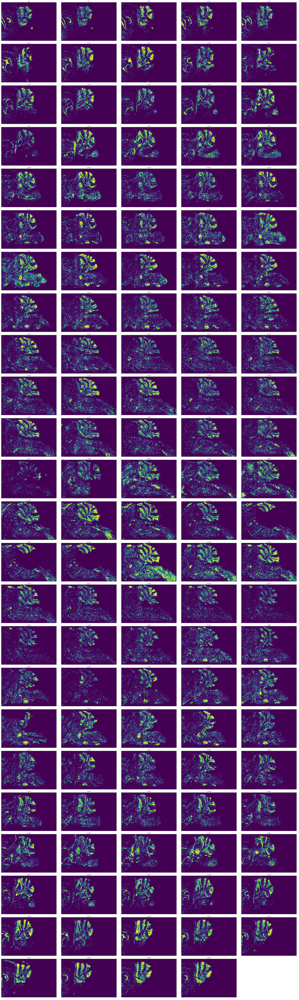

In [7]:
display_volume_sections(volume_outVolResol)